<a href="https://colab.research.google.com/github/TUIlmenauAMS/PsychoacousticLoss/blob/main/psyacLoss.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Psycho-Acoustic Loss Function

## using the psycho-acoustic model and normalization to the masking threshold

In [15]:
!git clone https://github.com/TUIlmenauAMS/Python-Audio-Coder
%cd Python-Audio-Coder

Cloning into 'Python-Audio-Coder'...
remote: Enumerating objects: 171, done.
remote: Counting objects: 100% (80/80), done.
remote: Compressing objects: 100% (80/80), done.
remote: Total 171 (delta 47), reused 0 (delta 0), pack-reused 91
Receiving objects: 100% (171/171), 9.73 MiB | 10.69 MiB/s, done.
Resolving deltas: 100% (81/81), done.
/content/Python-Audio-Coder/Python-Audio-Coder


In [16]:
import scipy.io.wavfile as wav
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio

%matplotlib inline

## Load Test Audio File

<ipython-input-17-f039057b9822>:2: WavFileWarning:

Chunk (non-data) not understood, skipping it.



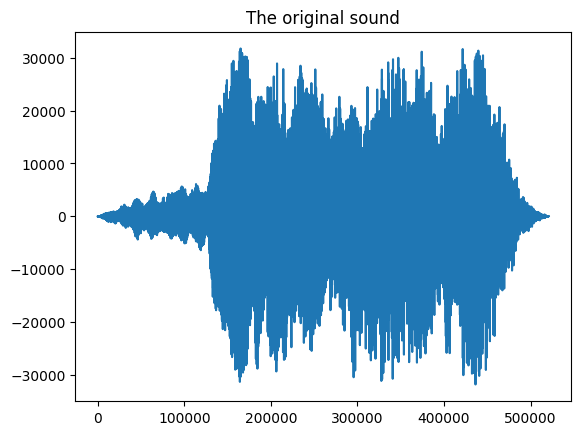

In [17]:
#Test audio file:
fs, snd =wav.read('fantasy-orchestra.wav')
plt.plot(snd[:,0])
plt.title("The original sound")

Audio('fantasy-orchestra.wav')

## Create different distorted versions
Uniform quantization:

In [18]:
import plotly.express as px
import plotly.tools as tls
import pandas as pd


#Audio signal with uniform quantization and de-quantization
snd_quant=(np.round(snd/10000))*10000
wav.write('fantasy-orchestra_quant.wav', rate= fs, data=snd_quant.astype(np.int16))

d = {'orig': snd[:,0], 'quant': snd_quant[:,0]}
df = pd.DataFrame(data=d)
fig=px.line(df,title="Originial and signal with uniform quantization and de-quantization")
fig.show()

#plt.plot(snd_quant[:,0])

Audio('fantasy-orchestra_quant.wav')

Psycho-acoustic quantization from AAC coding and decoding:

In [19]:
#Psycho-acoustic quantization from AAC coding and decoding:
!apt install ffmpeg
!ffmpeg -y -i fantasy-orchestra.wav -b:a 64k fantasy-orchestra64k.aac
!ffmpeg -y -i fantasy-orchestra64k.aac fantasy-orchestradec_aac.wav
print("Observe file size for compression ratio:")
!ls -l fantasy-orchestra64k.aac fantasy-orchestradec_aac.wav
#Listen:
Audio('fantasy-orchestradec_aac.wav')

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 19 not upgraded.
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq -

Observe: The AAC encoding/decoding delay needs to be compensated:

In [20]:
#Plot:
import plotly.express as px
import plotly.tools as tls
import pandas as pd

fs, snd_aac =wav.read('fantasy-orchestradec_aac.wav')

minlength=min(snd.shape[0],snd_aac.shape[0])
print("minlength=", minlength)
delay=120 #aac delay in samples
"""
fig, ax = plt.subplots(1,1)
plt.plot(snd[:minlength,0])
plt.plot(snd_aac[:minlength,0])
#plt.legend(('orig','aac'))
plotly_fig = tls.mpl_to_plotly(fig)
plotly_fig.layout.update(showlegend=True)
plotly_fig.show()
"""
#fig=px.line(np.vstack((snd[:minlength,0],snd_aac[:minlength,0])).T,labels={'orig','aac'})
#"""
d = {'orig': snd[:minlength-delay,0], 'aac': snd_aac[delay:minlength,0]}
df = pd.DataFrame(data=d)
fig=px.line(df, title="Original and with AAC Encoding and Decoding, Delay compensated")
#"""
fig.show()

snd=snd.astype(float)
snd_aac=snd_aac.astype(float)

#plt.plot((snd[:minlength-delay,0]-snd_aac[delay:minlength,0])**2)
#plt.show()

#write delay compensated signal to file, for quality measure:
wav.write('fantasy-orchestradec_aac_delcomp.wav', fs, snd_aac[delay:,:].astype(np.int16))

minlength= 520972


## MSE of Quantized and AAC encoded/decoded Version

In [21]:
#import torch.nn
from sklearn.metrics import mean_squared_error

#MSE needs float type to avoid overflow:
snd=snd.astype(float)
snd_quant=snd_quant.astype(float)

#mean squared error:
#loss_mse = torch.nn.MSELoss(size_average=True)
#loss_mse = torch.nn.MSELoss()
#loss_mse(snd,snd_quant)

mse_quant=mean_squared_error(snd,snd_quant)

#print("mean squared error of uniform quantization:", np.mean((snd-snd_quant)**2))
#print("Torch MSELoss:", loss_mse(snd,snd_quant))
print("Sklearn mean_squared_error of uniform quantization:", mse_quant)

mse_aac=mean_squared_error(snd[:minlength-delay,:],snd_aac[delay:minlength,:])
#print("mean squared error of mpeg quantization:", np.mean((snd[:minlength-delay,:]-snd_aac[delay:minlength,:])**2))
print("Skl mean squared error of mpeg quantization:",mse_aac)

print("ration mse_aac/mse_quant=",mse_aac/mse_quant)

Sklearn mean_squared_error of uniform quantization: 6310072.625274487
Skl mean squared error of mpeg quantization: 31224494.02425833
ration mse_aac/mse_quant= 4.948357313542025


Observe: the mean squared error for the AAC encoded/decoded version is much worse than for the uniform quantized version, even though listening to it shows that the AAC encdec signal sounds "orders of magnitude" better!

## Psycho-acoustic threshold function:

Testing with audio signal:

np.max(abs(snd))= 31831


<ipython-input-22-4eae289a39e0>:4: WavFileWarning:

Chunk (non-data) not understood, skipping it.



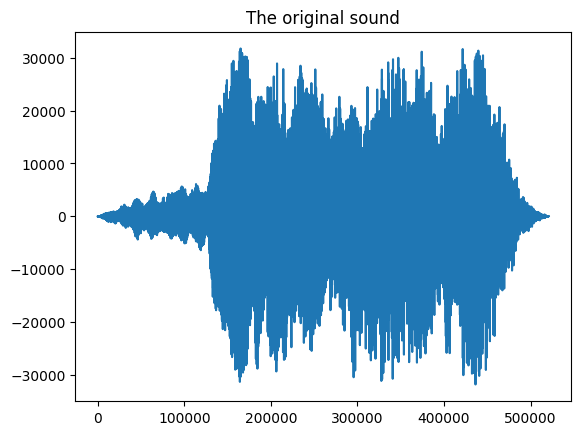

In [22]:
#Test audio file:
from IPython.display import Audio

fs, snd =wav.read('fantasy-orchestra.wav')
plt.plot(snd[:,0])
plt.title("The original sound")

print("np.max(abs(snd))=", np.max(abs(snd)))
Audio('fantasy-orchestra.wav')
#Audio(data=snd.astype(np.int16),rate=fs)


Compute and display masking threshold:

snd.shape= (520972, 2)
fs= 44100
mT.shape= (1025, 510)


Text(0.5, 1.0, 'Spectrogram of Original')

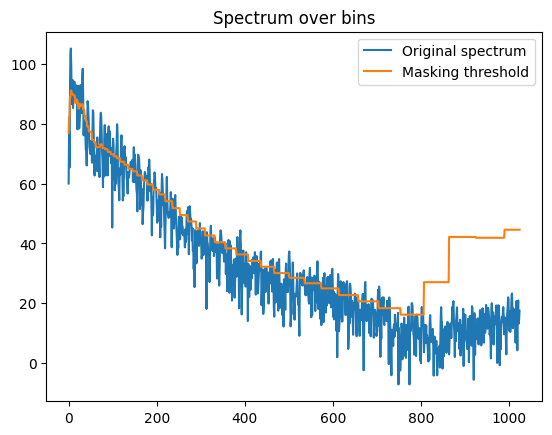

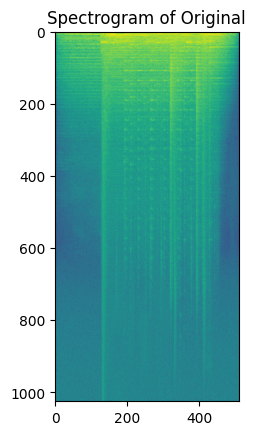

In [23]:
#Test function:
import scipy.signal
import psyacloss

nfft=2048  #number of fft subbands
N=nfft//2

print("snd.shape=", snd.shape)
f,t,ys=scipy.signal.stft(snd[:,0],fs=2*np.pi,nperseg=2*N)
#scaling for the application of the
#resulting masking threshold to MDCT subbands:
ys *= np.sqrt(2*N/2)/2/0.375

print("fs=", fs)
mT=psyacloss.psyacthresh(ys,fs)

print("mT.shape=",mT.shape)
plt.plot(20*np.log10(np.abs(ys[:,400])+1e-6))
plt.plot(20*np.log10(mT[:,400]+1e-6))
plt.legend(('Original spectrum','Masking threshold'))
plt.title("Spectrum over bins")

plt.figure()
plt.imshow(20*np.log10(np.abs(ys)+1e-6))
plt.title("Spectrogram of Original")


## The perceptual loss function:

Perceptual loss between original an quantized signal: 7809

In [24]:
ploss=psyacloss.percloss(snd, snd_quant, fs)
print("ploss=", ploss)
#plt.figure()
#plt.plot(20*np.log10(ploss[:,0,400]+1e-6))



ploss= 7809.09186451799


Perceptual loss between original and AAC encdec signal: 1.6

In [25]:
#print("snd_aac.shape=", snd_aac.shape)
#print("snd.shape=", snd.shape)
minlen=min(snd.shape[0],snd_aac.shape[0])
print("minlength=",minlength)
ploss_aac=psyacloss.percloss(snd[:minlen,:], snd_aac[:minlen,:], fs)
print("ploss_aac=",ploss_aac)

minlength= 520972
ploss_aac= 1.974040716609808


Observe: the perceptual loss for the AAC encdec signal is magnitudes smaller that for the uniform quantized signal, as it should to reflect the hearing properties!